### Что такое состязательные атаки?
`Adversarial attacks` — это злонамеренное манипулирование входными данными модели машинного обучения с целью заставить ее выдать неправильные предсказания.
### Виды
* `White Box` и `Black Box`. White Box соответствуют случаю, когда злоумышленник имеет полное представление о модели машинного обучения, включая ее архитектуру и параметры. В отличие от этого, атаки «Black Box», когда злоумышленник имеет ограниченные знания о модели машинного обучения или не имеет их вовсе, и для создания примеров противника ему приходится полагаться на метод проб и ошибок. Атаки Black Box наиболее приближены к реальности, а White Box чаще связаны с исследованиями в области Adversarial attacks.

В этом семинаре мы рассмотрим только `White-Box` атаки: в такой постановке простор для творчеста куда больше, чем в случае Black-Box. Большинство Black-Box атак сводятся либо к каким-либо эволюционным алгоритмам для оптимизации попиксельной добавки, либо атакуют дистиллированную модель White-Box методом с надеждой на то, что атака перенесется на целевую модель.

* `Targeted` и `Untargeted Attacks`. Targeted направлены на достижение определенного результата, например, неправильную классификацию изображения как определенного класса. В отличие от них, Untargeted атаки направлены на то, чтобы просто заставить модель выдать неверный результат, без указания желаемого результата. 

В случае с метриками качества изображений, четкого разделения атак на targeted/untargeted нет в силу специфики задачи. Мы рассмотрим `атаки на повышение значения метрики`, что можно считать аналогом `targeted` атаки (атаку, нацеленную на максимальную девиацию значения от исходного можно считать untargeted)

# White-box Adversarial Attacks on NR-IQA models

In [43]:
import pyiqa
from PIL import Image
import numpy as np
import pandas as pd
import cv2
import torch
from torchvision import transforms
from torchmetrics import StructuralSimilarityIndexMeasure, PeakSignalNoiseRatio
import warnings
warnings.filterwarnings('ignore')
# Заранее определим устройство, на котором будем проводить все вычисления. Этот ноутбук рассчитан на выполнение на видеокарте с поддержкой CUDA
DEVICE = 'cuda:0'
torch.cuda.get_device_properties(DEVICE)
torch.cuda.is_available()

_CudaDeviceProperties(name='NVIDIA GeForce RTX 4080', major=8, minor=9, total_memory=16375MB, multi_processor_count=76)

In [2]:
# Инструменты для визуализации
from matplotlib import pyplot as plt
import seaborn as sns

### Целевая модель

Атаковать будем метрику [TOPIQ](https://arxiv.org/pdf/2308.03060.pdf). Она основана на **CFANet** (coarse-to-fine network) архитектуре, заключающейся в пропагации признаков от более высокоуровневых (Coarse) к низкоуровневым (Fine).

![TOPIQ scheme](imgs/topiq_scheme.png)

Воспользуемся реализацией метрики из библиотеки **pyiqa**

In [3]:
iqa_model = pyiqa.create_metric(
                'topiq_nr',
                as_loss=True,
                device=DEVICE
            )
iqa_name = 'TOPIQ'
iqa_range = 1.0

Loading pretrained model CFANet from C:\Users\1\.cache\torch\hub\checkpoints\cfanet_nr_koniq_res50-9a73138b.pth


Для измерения искаженности изображения, воспользуемся Full-Reference метриками SSIM и PSNR

In [4]:
psnr = PeakSignalNoiseRatio().to(DEVICE)
ssim = StructuralSimilarityIndexMeasure(data_range=1.0).to(DEVICE)

## Аддитивные атаки

`Аддитивными` назовем атаки, заключающиеся в `прибавлении` к исходному изображению небольшой добавки (как правило, незаметной), которая существенно искажает выход модели:
$$x_{adv}=x + \delta$$
Как правило, $\delta$ ограничивается $L_{1}$ или $L_{inf}$ нормами: $||x_{adv}-x||_p < \epsilon$.

Существуют и другие способы атаки, перестраивающие изображения более существенно - в таких случаях попиксельная разница между оригинальным и атакованным изображением никак явно не ограничивается и может быть очень большой, хотя визуально изображения останутся похожими.

Каким образом можно построить аддитивную добавку $\delta$?

Хотя White-Box сценарий и позволяет эксплуатировать специфические архитектурные уязвимости конкретной модели, в большинстве случаев атаки используют лишь возможность получать градиент модели относительно входных данных.

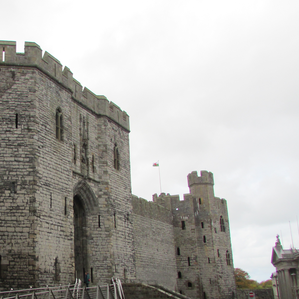

In [5]:
# Откроем изображение, с которым будем производить манипуляции
im_path = './prey_images/0ceee9a38409e30c.png'
img = Image.open(im_path)
img_tensor = transforms.ToTensor()(img).to(DEVICE).unsqueeze(0) # преобразуем изображение в тензор размерности 1 x 3 x H x W
img

Для начала, объявим несколько вспомогательных функций

In [6]:
# Функция, с помощью которой будем визуализировать градиенты
def grad_to_numpy(x):
    '''
    Преобразует градиент из [1,3,H,W] float в [H,W,3] uint8 массив, который можно визуализировать
    '''
    return np.clip(x.permute(0,2,3,1).squeeze().detach().cpu().numpy()*255.0 + 128, 0, 255).astype(np.uint8)

# Функция, с помощью которой будем визуализировать изображения в виде torch тензоров
def image_to_numpy(x):
    return np.clip(x.permute(0,2,3,1).squeeze().detach().cpu().numpy() * 255, 0, 255).astype(np.uint8)

# Функция для вычисления значения метрики до и после атаки, а также визуальных потерь в виде SSIM и PSNR
def calc_scores(clear, attacked):
    scores = {}
    with torch.no_grad():
        scores['clear'] = iqa_model(clear).item()
        scores['attacked'] = iqa_model(attacked).item()
        scores['SSIM'] = ssim(attacked, clear).item()
        scores['PSNR'] = psnr(attacked, clear).item()
    return scores

Попробуем извлечь из модели градиент до входного изображения и визуалилировать его. Для этого достаточно включить подсчет градиентов для входного изображения, посчитать значение целевой метрики, после чего сделать от него .backward(), пропустив градиенты через вычислительный граф torch'а.

Серый цвет означает околонулевое значение градиента (т.к. мы сместили его на +128). Как видно, величина градиента в пикселях достаточно маленькая, и без дополнительного увеличения его вообще не видно на визуализации:

Gradient maximum abs. value (in [0,1] scale): 0.020, mean: 0.001


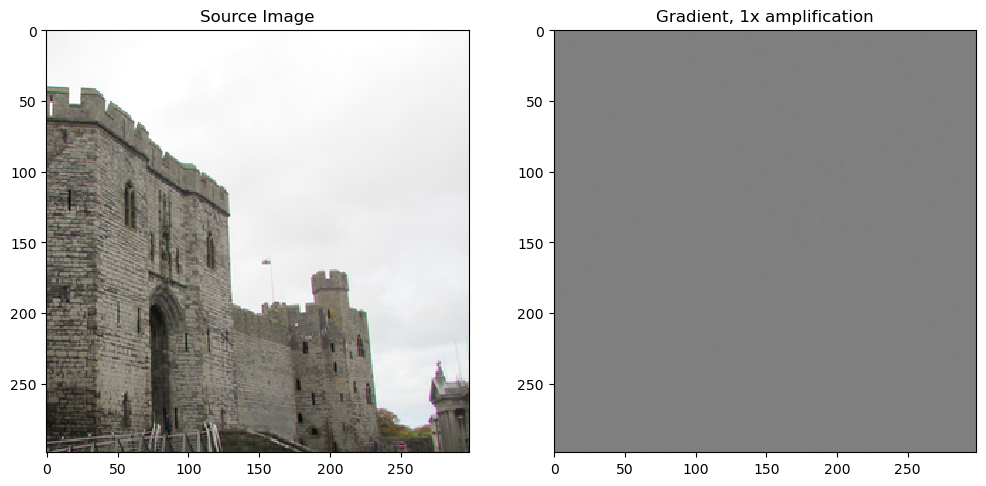

In [11]:
K = 1 # коэффициент увеличения градиента при визуализации
cloned_img = img_tensor.clone()
cloned_img.requires_grad = True # Включим вычисление градиентов относительно изображения
iqa_clear_value = iqa_model(cloned_img)
# Само значение метрики можно использовать как лосс
iqa_clear_value.backward() 
# backward() вычисляет градиенты до всех тензоров с requires_grad = True в вычислительном графе, само изображение в этот момент не изменяется
# У изображения появляяется непустое поле grad, в котором и хранится градиент
fig = plt.figure(figsize=(12,6))
ax = plt.subplot(1,2, 1, label='asd')
plt.imshow(np.array(img), interpolation='none')
ax.set_title("Source Image")
ax2 = plt.subplot(1,2, 2)
plt.imshow(grad_to_numpy(cloned_img.grad  * K), interpolation='none')
ax2.set_title(f"Gradient, {K}x amplification")
print(f'Gradient maximum abs. value (in [0,1] scale): {torch.abs(cloned_img.grad).max().item():.3f}, mean: {torch.abs(cloned_img.grad).mean().item():.3f}')

С увеличением уже можно разглядеть, что градиент на самом деле не нулевой, и содержит в себе структурную информацию. Попробуем теперь визуалилировать знак градиента:

Text(0.5, 1.0, 'Sign of the gradient')

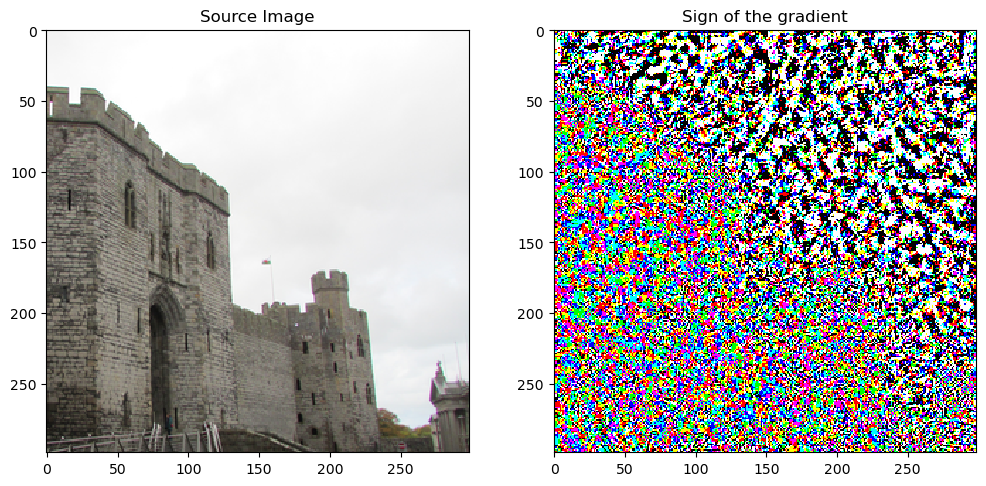

In [12]:
fig = plt.figure(figsize=(12,6))
ax = plt.subplot(1,2, 1, label='asd')
plt.imshow(np.array(img), interpolation='none')
ax.set_title("Source Image")
ax2 = plt.subplot(1,2, 2)
plt.imshow(grad_to_numpy(torch.sign(cloned_img.grad)), interpolation='none')
ax2.set_title("Sign of the gradient")

Хотя визуализация градиента и превратилось в кашу из разных цветов, на ней можно явно увидеть, что в области со зданием цвета больше, а значит там больше ненулевых величин в градиенте: посколько в результате применения операции взятия знака получился тензор со значениями {-1,0,1} в каждом из цветовых каналов, при преобразовании *255 + 128 получили соответствующее множество RGB цветов `{0/128/255,0/128/255,0/128/255}`.

### FGSM: Fast Gradient Sign Method
Во многих атаках вместо "сырого" градиента используют его знак. Это одновременно ограничивает атаку в случае большого по модулю градиента, и усиливает ее в обратном случае. 
Первой и одной из самых распространенных атак является `Fast Gradient Sign Method`.

Метод крайне прост: просто прибавим к исходному изображению градиент, квантованный до знака, с некоторым коэффициентом. 

![Adversarial attack on image classifier](imgs/panda.png)

In [7]:
def fgsm_attack(image, target_model, epsilon=2./255.):
    '''
    image: torch.Tensor of shape [1,3,H,W]
    target_model: torch model that allows gradient propagation
    epsilon: attack's strength, float value (L_inf distance from source image)
    '''
    perturbed_image = image.clone()
    perturbed_image.requires_grad = True
    value = target_model(perturbed_image.to(DEVICE))
    # Вычисляем градиент
    value.backward()
    # берем от него знак
    signed_data_grad = torch.sign(perturbed_image.grad)
    # прибавляем с небольшим коэффициентом к изображению
    perturbed_image = perturbed_image + epsilon * signed_data_grad
    perturbed_image = torch.clamp(perturbed_image, 0, 1)
    return perturbed_image


Теперь атакуем изображение и посмотрим что получилось

In [31]:
# получим атакованное изображение
attacked_img_tensor = fgsm_attack(img_tensor, iqa_model, epsilon=4/255.)

# Посчитаем значения метрики до и после атаки
vals = calc_scores(img_tensor, attacked_img_tensor)

Epsilon: 4/255, SSIM: 0.901, PSNR: 36.267


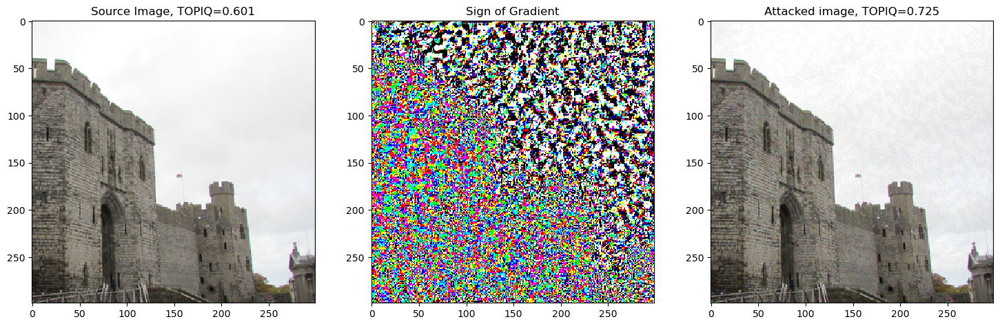

In [32]:
fig = plt.figure(figsize=(18,6))
ax = plt.subplot(1,3, 1, label='asd')
plt.imshow(np.array(img), interpolation='none')
ax.set_title(f"Source Image, {iqa_name}={vals['clear']:.3f}")
ax2 = plt.subplot(1,3, 2)
plt.imshow(grad_to_numpy(torch.sign(cloned_img.grad)), interpolation='none')
ax2.set_title("Sign of Gradient")
ax2 = plt.subplot(1,3, 3)
plt.imshow(image_to_numpy(attacked_img_tensor), interpolation='none')
ax2.set_title(f"Attacked image, {iqa_name}={vals['attacked']:.3f}")
print(f"Epsilon: 4/255, SSIM: {vals['SSIM']:.3f}, PSNR: {vals['PSNR']:.3f}")

Попробуем регулировать силу атаки, меняя эпсилон - максимальную попиксельную разницу между оригинальным и атакованным изображением

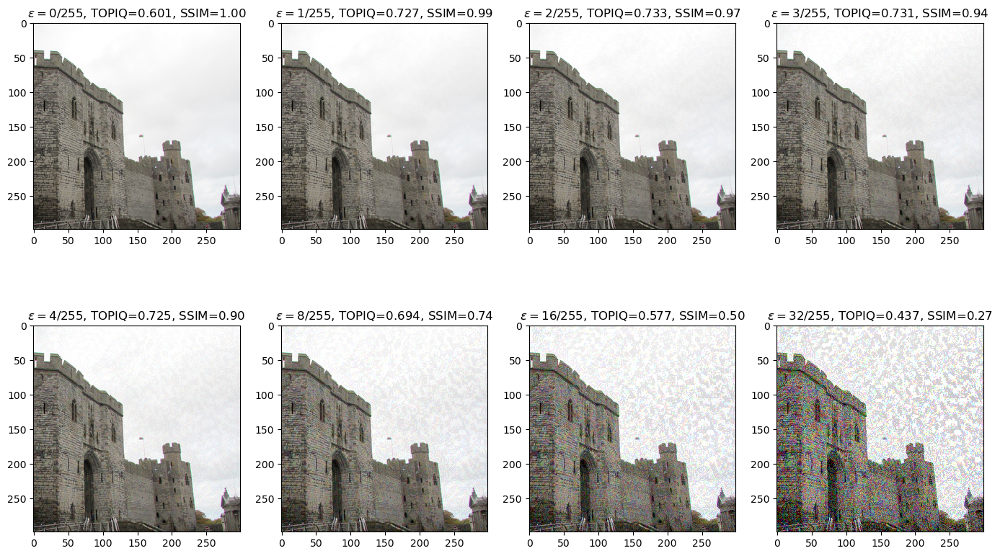

In [63]:
epsilons = np.array([0,1,2,3,4,8,16,32])
attacked_img_tensors = [fgsm_attack(img_tensor, iqa_model, epsilon=x / 255.0) for x in epsilons]
with torch.no_grad():
    attacked_values = [iqa_model(x).item() for x in attacked_img_tensors]
    ssim_values = [ssim(x, img_tensor).item() for x in attacked_img_tensors]

fig = plt.figure(figsize=(17,10))
n_cols = 4
n_rows = len(epsilons) // n_cols
for i in range(len(epsilons)):
    ax = plt.subplot(n_rows,n_cols, i + 1)
    plt.imshow(image_to_numpy(attacked_img_tensors[i]), interpolation='none')
    ax.set_title(f"$\\epsilon={epsilons[i]}/255$, {iqa_name}={attacked_values[i]:.3f}, SSIM={ssim_values[i]:.2f}") 

Как видим, начиная с некоторого момента, увеличивать коэффициент становится бесполезно, градиент, квантизованный до знака, слишком неточен, чтобы эффективно атаковать модель.

### Iterative FGSM

Теперь попробуем вместо одного прибавления знака градиента прибавлять его итеративно. В таком случае, у нас появляется 2 параметра: $\epsilon$, ограничивающий максимальную попиксельную разницу, и еще один параметр, назовем его $\alpha$, который будет регулировать величину шага, как $\epsilon$ в обычном FGSM.

Аккумулировать создаваемую таким образом добавку будем в отдельном тензоре (p), который будем прибавлять к изображению перед вычислением метрики

In [8]:
def ifgsm_attack(image, target_model, epsilon=2./255., alpha=1/255., iters=10):
    '''
    image: torch.Tensor of shape [1,3,H,W]
    target_model: torch model that allows gradient propagation
    epsilon: Maximum allowable pixel-wise distance to source image, float value (L_inf distance from source image)
    alpha: step size of the attack, float
    iters: number of iterations, int
    '''
    # само изображение оптимизировать не будем, но его тоже придется сделать переменной, чтобы torch нормально считал градиент до p
    perturbed_image = torch.autograd.Variable(image.clone(), requires_grad=True)
    
    # оптимизируемая добавка
    p = torch.zeros_like(image).to(DEVICE)
    p = torch.autograd.Variable(p, requires_grad=True)

    for i in range(iters):
        tmp = perturbed_image + p
        #tmp = torch.clamp(tmp, 0, 1)
        value = target_model(tmp.to(DEVICE))
        # Вычисляем градиент
        value.backward()
        # берем от него знак
        signed_data_grad = torch.sign(p.grad)
        # прибавляем с небольшим коэффициентом градиент к добавке
        p.data = p.data + alpha * signed_data_grad
        # ограничиваем добавку в [-eps,+eps]
        p.data.clamp_(-epsilon, epsilon)
        p.grad.zero_()
    
    perturbed_image = torch.clamp(image + p, 0, 1)
    return perturbed_image

In [59]:
# получим атакованное изображение
attacked_img_tensor_fgsm = fgsm_attack(img_tensor, iqa_model, epsilon=4/255.)
attacked_img_tensor_ifgsm = ifgsm_attack(img_tensor, iqa_model, epsilon=4/255., alpha=1/255., iters=10)

# Вычислим значение метрики и близость к исходному изображению
vals_fgsm = calc_scores(img_tensor, attacked_img_tensor_fgsm)
vals_ifgsm = calc_scores(img_tensor, attacked_img_tensor_ifgsm)

Text(0.5, 1.0, 'IFGSM,  $\\epsilon$=4/255, TOPIQ=0.967, SSIM=0.95')

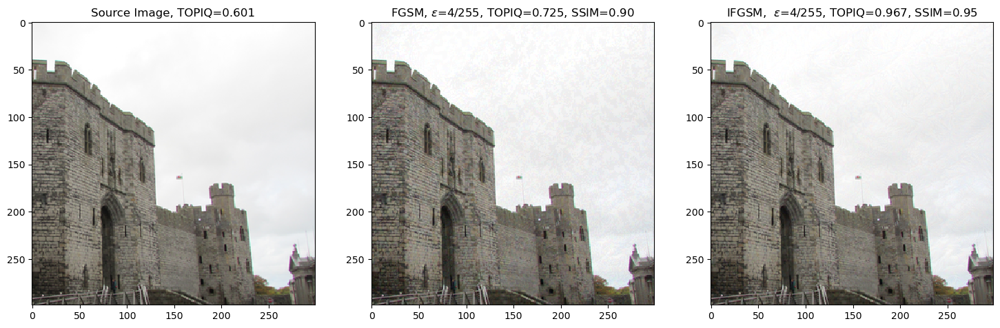

In [64]:
fig = plt.figure(figsize=(18,6))
ax = plt.subplot(1,3, 1, label='asd')
plt.imshow(np.array(img), interpolation='none')
ax.set_title(f"Source Image, {iqa_name}={vals_fgsm['clear']:.3f}")

ax2 = plt.subplot(1,3, 2)
plt.imshow(image_to_numpy(attacked_img_tensor_fgsm), interpolation='none')
ax2.set_title(f"FGSM, $\\epsilon$=4/255, {iqa_name}={vals_fgsm['attacked']:.3f}, SSIM={vals_fgsm['SSIM']:.2f}")

ax2 = plt.subplot(1,3, 3)
plt.imshow(image_to_numpy(attacked_img_tensor_ifgsm), interpolation='none')
ax2.set_title(f"IFGSM,  $\\epsilon$=4/255, {iqa_name}={vals_ifgsm['attacked']:.3f}, SSIM={vals_ifgsm['SSIM']:.2f}")
#print(f'Epsilon: 4/255, SSIM: {ssim_val:.3f}, PSNR: {psnr_val:.3f}')

Невооруженным глазом видно, что атака стала менее заметной, и прирост метрики получился повыше.

Попробуем варьировать величину шага при фиксированном $\epsilon$=8:

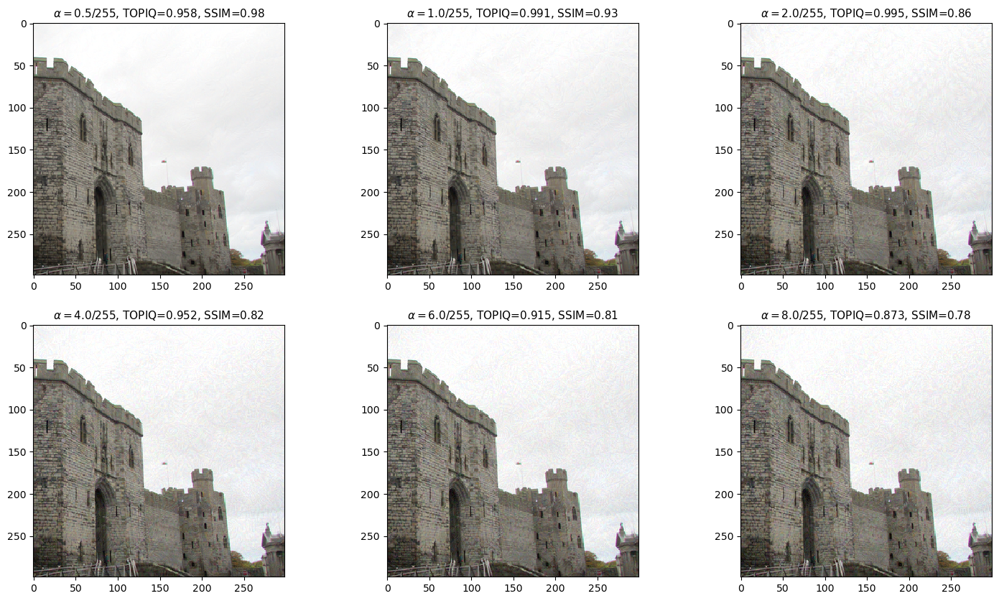

In [71]:
alphas = np.array([0.5, 1, 2, 4, 6, 8])
attacked_img_tensors = [ifgsm_attack(img_tensor, iqa_model, epsilon=8/255., alpha=x / 255.0, iters=10) for x in alphas]
with torch.no_grad():
    attacked_values = [iqa_model(x).item() for x in attacked_img_tensors]
    ssim_values = [ssim(x, img_tensor).item() for x in attacked_img_tensors]

fig = plt.figure(figsize=(18,10))
n_cols = 3
n_rows = len(alphas) // n_cols
for i in range(len(alphas)):
    ax = plt.subplot(n_rows,n_cols, i + 1)
    plt.imshow(image_to_numpy(attacked_img_tensors[i]), interpolation='none')
    ax.set_title(f"$\\alpha={alphas[i]}/255$, {iqa_name}={attacked_values[i]:.3f}, SSIM={ssim_values[i]:.2f}", fontsize=11) 

Теперь посмотрим, как на силу атаки влияет число итераций. Заодно посмотрим, как скейлятся с числом итераций разные значения величины шага $\alpha$:

In [84]:
iters = np.array(range(1,16,1))
alphas = [0.5, 1, 3, 6]
attacked_imgs_dict = {}
for a in alphas:
    attacked_imgs_dict[a] = [ifgsm_attack(img_tensor, iqa_model, epsilon=8/255., alpha=a / 255.0, iters=x) for x in iters]
attacked_vals_dict = {}
ssim_dict = {}
with torch.no_grad():
    for a in alphas:
        attacked_vals_dict[a] = [iqa_model(x).item() for x in attacked_imgs_dict[a]]
        ssim_dict[a] = [ssim(x, img_tensor).item() for x in attacked_imgs_dict[a]]

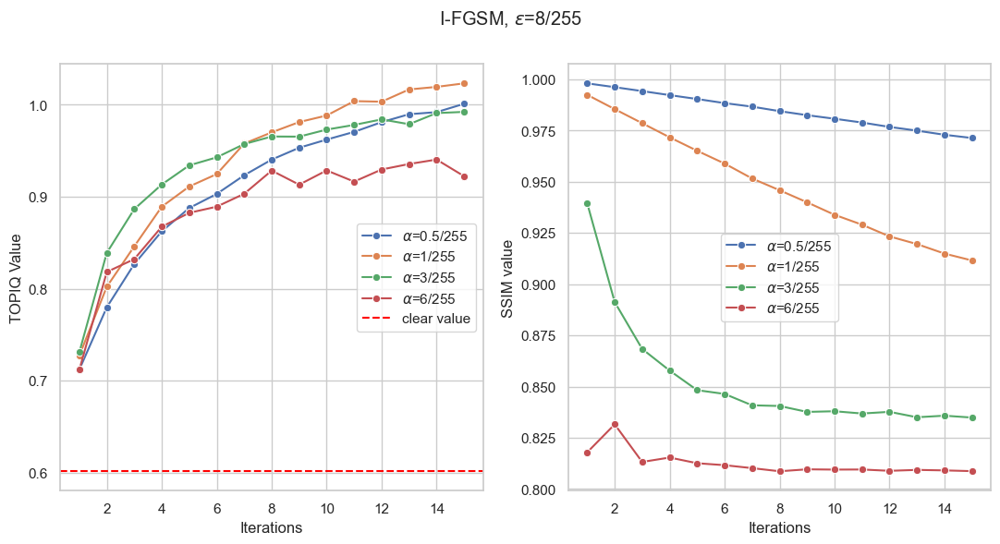

In [89]:
sns.set(style='whitegrid')
plt.figure(figsize=(13,6))
plt.suptitle('IFGSM, $\\epsilon$=8/255')
ax = plt.subplot(1,2, 1)
for a in alphas:
    sns.lineplot(x=iters, y=attacked_vals_dict[a], ax=ax, label=f'$\\alpha$={a}/255', marker='o')
ax.axhline(vals_ifgsm['clear'], 0, 1, color='red', label='clear value', linestyle='--')
ax.set_xlabel('Iterations')
ax.set_ylabel('TOPIQ Value')
plt.legend()

ax = plt.subplot(1,2, 2)
for a in alphas:
    sns.lineplot(x=iters, y=ssim_dict[a], ax=ax, marker='o', label=f'$\\alpha$={a}/255')
ax.set_xlabel('Iterations')
ax.set_ylabel('SSIM value')
plt.legend()

Еще визуализации:

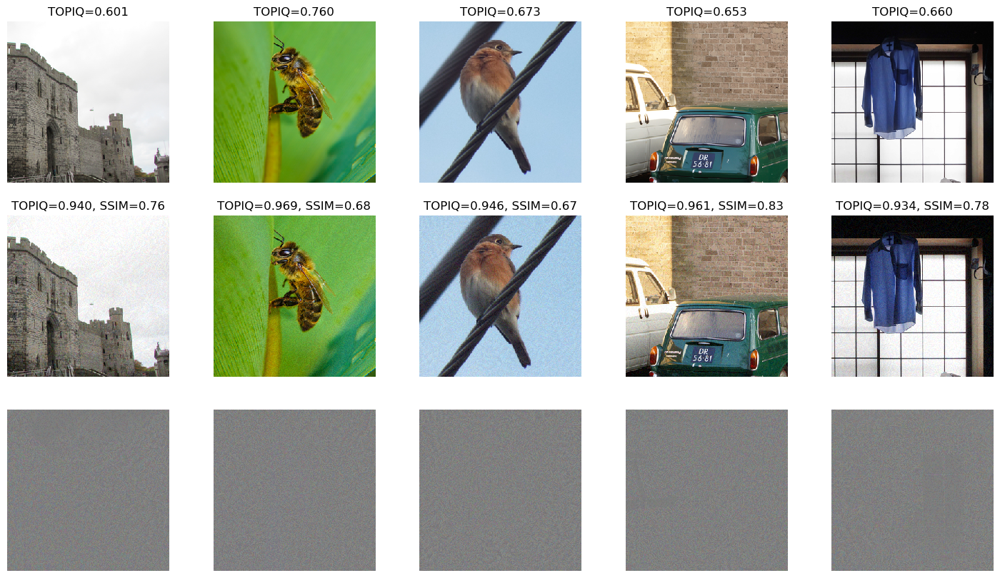

In [14]:
import os
from pathlib import Path
img_tensors = [transforms.ToTensor()(Image.open(str(x))).unsqueeze(0).to(DEVICE) for x in Path('./prey_images').iterdir()]
attacked_tensors = [ifgsm_attack(image=x, target_model=iqa_model, epsilon=10/255., alpha=6/255., iters=10) for x in img_tensors]
img_vals = [calc_scores(img_tensors[x],attacked_tensors[x]) for x in range(len(img_tensors))]
n_rows = 3
plt.figure(figsize=(18,10))
for i in range(len(img_tensors)):
    ax = plt.subplot(n_rows,len(img_tensors), i + 1)
    ax.set_title(f'{iqa_name}={img_vals[i]["clear"]:.3f}')
    ax.axis('off')
    plt.imshow(image_to_numpy(img_tensors[i]), interpolation='none')

for i in range(len(attacked_tensors)):
    ax = plt.subplot(n_rows,len(attacked_tensors), len(attacked_tensors) + i + 1)
    ax.set_title(f'{iqa_name}={img_vals[i]["attacked"]:.3f}, SSIM={img_vals[i]["SSIM"]:.2f}')
    ax.axis('off')
    plt.imshow(image_to_numpy(attacked_tensors[i]), interpolation='none')

for i in range(len(attacked_tensors)):
    ax = plt.subplot(n_rows,len(attacked_tensors), 2*len(attacked_tensors) + i + 1)
    ax.axis('off')
    plt.imshow(image_to_numpy(attacked_tensors[i] - img_tensors[i] + 0.5), interpolation='none')

Первая строка - исходные изображения, вторая - атакованные с помощью I-FGSM, третья - попиксельная разница между ними. Как видно, атака добавляет высокочастотные шумы примерно равномерно по всей картинке, и это бросается в глаза. Заметим также, что наиболее заметен шум в областях с малым количеством высокочастотной информации: на небе и других монотонных областях.

### Маскируем атаку

Попробуем "сокрыть" атаку: будем добавлять обученный шум только в те области, в которых много деталей. Для этого сформируем соответствующую маску.

Как можно выделить нужные области на изображении? 

Существует много разных способов, например, частотное разложение изображения с помощью DWT (Discrete Wavelet Transform) или вычисление локальной дисперсии. Мы же попробуем один из самых простых и при этом эффективных подходов: выделим на изображении границы с помощью фильтров Собеля.

![Sobel filters](imgs/sobel_filters.png)

In [9]:
from scipy import ndimage
import cv2
def rgb2ycbcr(im_rgb):
    im_rgb = im_rgb.astype(np.float32)
    im_ycrcb = cv2.cvtColor(im_rgb, cv2.COLOR_RGB2YCR_CB)
    im_ycbcr = im_ycrcb[:,:,(0,2,1)].astype(np.float32)
    im_ycbcr[:,:,0] = (im_ycbcr[:,:,0]*(235-16)+16)/255.0
    im_ycbcr[:,:,1:] = (im_ycbcr[:,:,1:]*(240-16)+16)/255.0
    return im_ycbcr

def sobel_mask(im):
    im = im.cpu().detach().permute(0, 2, 3, 1).numpy()[0]
    #H = np.array([[-1, -2, -1], [0, 0, 0], [1, 2, 1]]) / 8  
    im = rgb2ycbcr(im)
    im_sob_h = ndimage.sobel(im[:,:,0], 0)
    im_sob_w = ndimage.sobel(im[:,:,0], 1)
    sob_magnitude = np.sqrt(im_sob_h**2 + im_sob_w**2)
    maxval = sob_magnitude.max()
    if maxval == 0:
        sob_magnitude = sob_magnitude + 1
        maxval = 1
    return sob_magnitude /maxval

def dilate_mask(mask):
    DF = np.array([[0, 1, 1, 1, 0], 
        [1, 1, 1, 1, 1], 
        [1, 1, 1, 1, 1], 
        [1, 1, 1, 1, 1], 
        [0, 1, 1, 1, 0]]).astype('uint8')
  
    out_im = cv2.dilate(mask, DF)
    return out_im

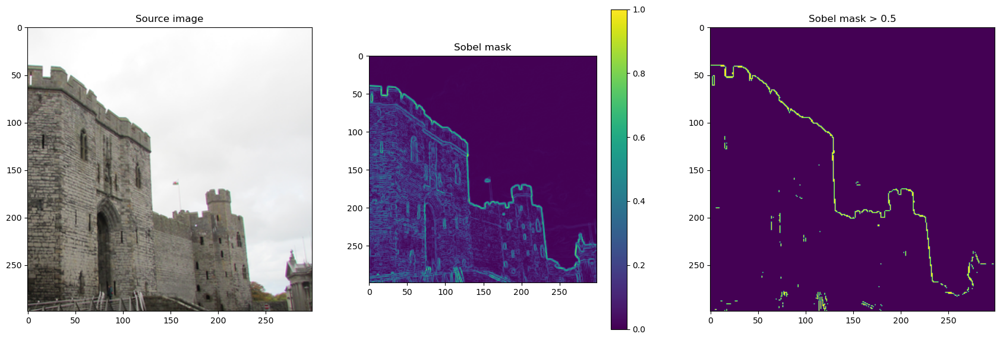

In [38]:
plt.figure(figsize=(21,7))
ax = plt.subplot(1,3,1)
ax.set_title('Source image')
plt.imshow(img)
ax = plt.subplot(1,3,2)
ax.set_title('Sobel mask')
plt.imshow(sobel_mask(img_tensor))
plt.colorbar()
ax = plt.subplot(1,3,3)
ax.set_title('Sobel mask > 0.5')
plt.imshow(sobel_mask(img_tensor) > 0.5)

Как видно, получилось достаточно неплохо: на небе маска почти везде равна нулю. Однако она слишком "точечная": значения маски достаточно большие в очень ограниченной области вокруг четких границ. Поэтому немного расширим маску: это можно сделать, например, размытием по Гауссу, но мы вместо этого применим морфологическую операцию **dilate** ("расширение") из opencv.

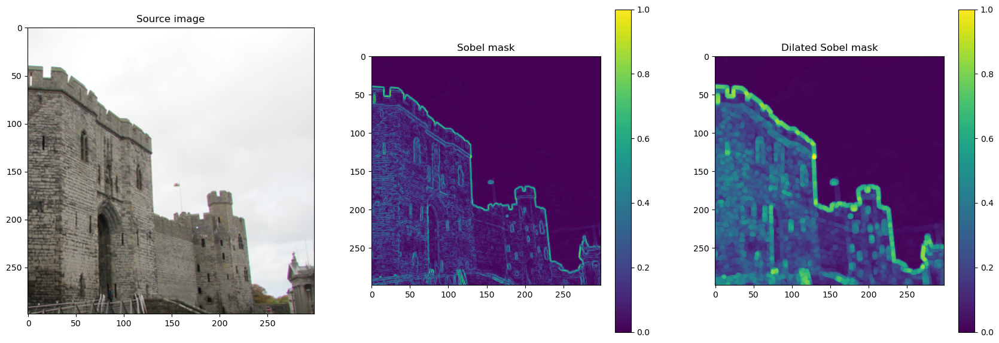

In [41]:
plt.figure(figsize=(21,7))
ax = plt.subplot(1,3,1)
ax.set_title('Source image')
plt.imshow(img)
ax = plt.subplot(1,3,2)
ax.set_title('Sobel mask')
plt.imshow(sobel_mask(img_tensor))
plt.colorbar()
ax = plt.subplot(1,3,3)
ax.set_title('Dilated Sobel mask')
plt.imshow(dilate_mask(sobel_mask(img_tensor)))
plt.colorbar()

Теперь внедрим операцию маскирования в I-FGSM:

In [10]:
def make_mask(im):
    return dilate_mask(sobel_mask(im))

def masked_ifgsm_attack(image, target_model, epsilon=2./255., alpha=1/255., iters=10, masking_func=make_mask):
    '''
    image: torch.Tensor of shape [1,3,H,W]
    target_model: torch model that allows gradient propagation
    epsilon: Maximum allowable pixel-wise distance to source image, float value (L_inf distance from source image)
    alpha: step size of the attack, float
    iters: number of iterations, int
    '''
    # Создадим маску как показано выше. Маска создается до атаки и неменяется в процессе
    mask = masking_func(image)
    # преобразуем в torch tensor
    mask = torch.tensor(mask.astype(np.float32)).unsqueeze(0).to(DEVICE)

    # Весь остальной процесс оставим почти без изменений: маску используем только на этапе прибавления градиента
    perturbed_image = torch.autograd.Variable(image.clone(), requires_grad=True)
    p = torch.zeros_like(image).to(DEVICE)
    p = torch.autograd.Variable(p, requires_grad=True)

    for i in range(iters):
        tmp = perturbed_image + p
        #tmp = torch.clamp(tmp, 0, 1)
        value = target_model(tmp.to(DEVICE))
        # Вычисляем градиент
        value.backward()
        # берем от него знак
        signed_data_grad = torch.sign(p.grad)
        # прибавляем с небольшим коэффициентом и маской к добавке
        p.data = p.data + alpha * mask * signed_data_grad
        # ограничиваем добавку в [-eps,+eps]
        p.data.clamp_(-epsilon, epsilon)
        p.grad.zero_()
    
    perturbed_image = torch.clamp(image + p, 0, 1)
    return perturbed_image

In [54]:
attacked_fgsm = fgsm_attack(img_tensor, iqa_model, epsilon=10./255)
attacked_ifgsm = ifgsm_attack(img_tensor, iqa_model, epsilon=10./255, alpha=3./255, iters=10)
attacked_masked_ifgsm = masked_ifgsm_attack(img_tensor, iqa_model, epsilon=10./255,  alpha=3./255, iters=10, masking_func=make_mask)

vals_ifgsm = calc_scores(img_tensor, attacked_ifgsm)
vals_masked_ifgsm = calc_scores(img_tensor, attacked_masked_ifgsm)
vals_fgsm = calc_scores(img_tensor, attacked_fgsm)

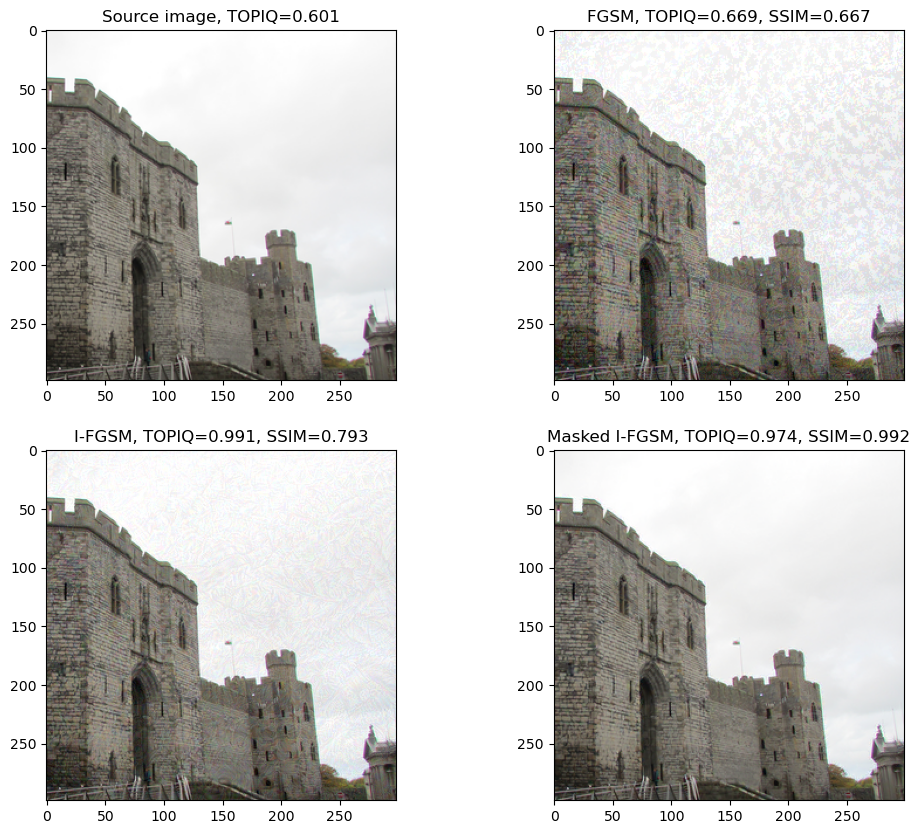

In [61]:
plt.figure(figsize=(12,10))
ax = plt.subplot(2,2,1)
ax.set_title(f'Source image, {iqa_name}={vals_ifgsm["clear"]:.3f}')
plt.imshow(img)
ax = plt.subplot(2,2,2)
ax.set_title(f'FGSM, {iqa_name}={vals_fgsm["attacked"]:.3f}, SSIM={vals_fgsm["SSIM"]:.3f}')
plt.imshow(image_to_numpy(attacked_fgsm))
ax = plt.subplot(2,2,3)
ax.set_title(f'I-FGSM, {iqa_name}={vals_ifgsm["attacked"]:.3f}, SSIM={vals_ifgsm["SSIM"]:.3f}')
plt.imshow(image_to_numpy(attacked_ifgsm))
ax = plt.subplot(2,2,4)
ax.set_title(f'Masked I-FGSM, {iqa_name}={vals_masked_ifgsm["attacked"]:.3f}, SSIM={vals_masked_ifgsm["SSIM"]:.3f}')
plt.imshow(image_to_numpy(attacked_masked_ifgsm))


Видно, что стало намного лучше. Посмотрим на попиксельную разницу с исходным изображением

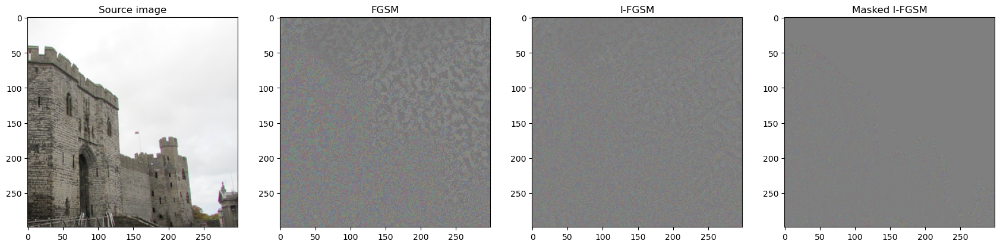

In [55]:
plt.figure(figsize=(21,7))
ax = plt.subplot(1,4,1)
ax.set_title(f'Source image')
plt.imshow(img)
ax = plt.subplot(1,4,2)
ax.set_title(f'FGSM')
plt.imshow(image_to_numpy(attacked_fgsm - img_tensor + 0.5))
ax = plt.subplot(1,4,3)
ax.set_title(f'I-FGSM')
plt.imshow(image_to_numpy(attacked_ifgsm - img_tensor + 0.5))
ax = plt.subplot(1,4,4)
ax.set_title(f'Masked I-FGSM')
plt.imshow(image_to_numpy(attacked_masked_ifgsm - img_tensor + 0.5))


Если приглядеться, видно, что на последней визуализации разница есть только на границах, а на небе никаких шумов нет, в отличие от FGSM и I-FGSM. Заодно посмотрим, как такая атака масштабируется по сравнению с обычным I-FGSM

In [65]:
iters = np.array(range(1,16,2))
alphas = [1, 3]
eps = 8/255.
attacked_imgs_ifgsm = {}
attacked_imgs_m_ifgsm = {}
for a in alphas:
    attacked_imgs_ifgsm[a] = [ifgsm_attack(img_tensor, iqa_model, epsilon=eps, alpha=a / 255.0, iters=x) for x in iters]
    attacked_imgs_m_ifgsm[a] = [masked_ifgsm_attack(img_tensor, iqa_model, epsilon=eps, alpha=a / 255.0, iters=x) for x in iters]
attacked_vals_ifgsm = {}
attacked_vals_m_ifgsm = {}
ssim_ifgsm = {}
ssim_m_ifgsm = {}
with torch.no_grad():
    for a in alphas:
        attacked_vals_ifgsm[a] = [iqa_model(x).item() for x in attacked_imgs_ifgsm[a]]
        attacked_vals_m_ifgsm[a] = [iqa_model(x).item() for x in attacked_imgs_m_ifgsm[a]]
        ssim_ifgsm[a] = [ssim(x, img_tensor).item() for x in attacked_imgs_ifgsm[a]]
        ssim_m_ifgsm[a] = [ssim(x, img_tensor).item() for x in attacked_imgs_m_ifgsm[a]]


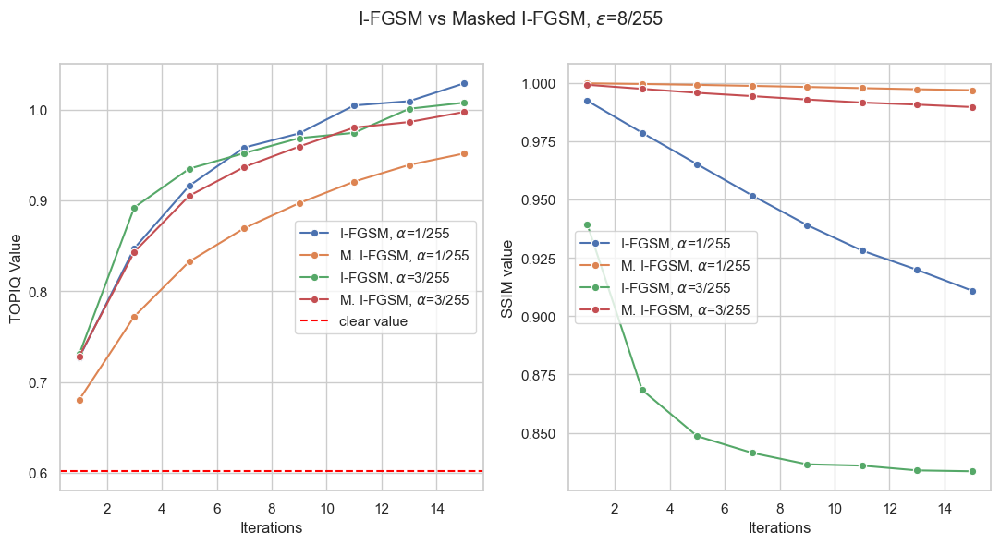

In [67]:
sns.set(style='whitegrid')
plt.figure(figsize=(13,6))
plt.suptitle('I-FGSM vs Masked I-FGSM, $\\epsilon$=8/255')
ax = plt.subplot(1,2, 1)
for a in alphas:
    sns.lineplot(x=iters, y=attacked_vals_ifgsm[a], ax=ax, label=f'I-FGSM, $\\alpha$={a}/255', marker='o')
    sns.lineplot(x=iters, y=attacked_vals_m_ifgsm[a], ax=ax, label=f'M. I-FGSM, $\\alpha$={a}/255', marker='o')
ax.axhline(vals_ifgsm['clear'], 0, 1, color='red', label='clear value', linestyle='--')
ax.set_xlabel('Iterations')
ax.set_ylabel('TOPIQ Value')
plt.legend()

ax = plt.subplot(1,2, 2)
for a in alphas:
    sns.lineplot(x=iters, y=ssim_ifgsm[a], ax=ax, marker='o', label=f'I-FGSM, $\\alpha$={a}/255')
    sns.lineplot(x=iters, y=ssim_m_ifgsm[a], ax=ax, marker='o', label=f'M. I-FGSM, $\\alpha$={a}/255')
ax.set_xlabel('Iterations')
ax.set_ylabel('SSIM value')
plt.legend()

Как видно по графикам, масштабируется по числу итераций маскированный I-FGSM не хуже обычного, при этом проседание по SSIM значительно меньше. Эффективность, конечно, немного просела (хотя при $\alpha$=3/255 это почти не заметно), но это небольшая плата за существенное снижение заметности. 

Стоит также отметить, что у такого метода маскирования могут начаться проблемы, если на изображении нет четких границ, к которым смогла бы прицепиться атака.

## Предобучаемые атаки

Цель предобучаемых атак - получить такую добавку к изображению (или любое другое настраиваемое преобразование), чтобы оно достаточно эффективно атаковало целевую модель при применении к любому изображению. При этом, на стадии применения мы не можем использовать модель - только применять заранее подготовленные преобразования.

Эффективность таких атак, как правило, существенно ниже, чем у итеративных градиентных атак, зато применимость в реальных сценариях может быть сильно выше, как и скорость применения, за счет низкой вычислительной сложности и потребления памяти, т.к. не надо считать градиент с помощью backpropagation.

### CNN-based атака

Попробуем обучить UNet-like модель, которая бы принимала на вход изображение и генерировала бы к нему атакующую добавку. Обучим модель на подвыборке из 10к изображений из датасета COCO. Поскольку для обучения не нужна разметка, обучать такую атаку можно на **любом множестве изображений**.

Показанная ниже модель работает в разрешении 256x256, что накладывает определенные ограничения на ее использование. Избавится от этого ограничения можно разными методами, например подавать изображение на вход кропами, и потом склеивать добавку, или взять не зависящую от входного разрешения архитектуру для модели. Мы же ограничимся простым ресайзом перед подачей в сеть и обратным ресайзом добавки к исходному разрешению изображения перед прибавлением.

In [11]:
from torch import nn
# Классическая unet-топодобная архитектура
class UnetGenerator(nn.Module):
    def __init__(self, input_nc, output_nc, ngf, norm_type='batch', act_type='selu'):
        super(UnetGenerator, self).__init__()
        self.name = 'unet'
        self.conv1 = nn.Conv2d(input_nc, ngf, 4, 2, 1)
        self.conv2 = nn.Conv2d(ngf, ngf * 2, 4, 2, 1)
        self.conv3 = nn.Conv2d(ngf * 2, ngf * 4, 4, 2, 1)
        self.conv4 = nn.Conv2d(ngf * 4, ngf * 8, 4, 2, 1)
        self.conv5 = nn.Conv2d(ngf * 8, ngf * 8, 4, 2, 1)
        self.conv6 = nn.Conv2d(ngf * 8, ngf * 8, 4, 2, 1)
        self.conv7 = nn.Conv2d(ngf * 8, ngf * 8, 4, 2, 1)
        self.conv8 = nn.Conv2d(ngf * 8, ngf * 8, 4, 2, 1)
        self.dconv1 = nn.ConvTranspose2d(ngf * 8, ngf * 8, 4, 2, 1)
        self.dconv2 = nn.ConvTranspose2d(ngf * 8 * 2, ngf * 8, 4, 2, 1)
        self.dconv3 = nn.ConvTranspose2d(ngf * 8 * 2, ngf * 8, 4, 2, 1)
        self.dconv4 = nn.ConvTranspose2d(ngf * 8 * 2, ngf * 8, 4, 2, 1)
        self.dconv5 = nn.ConvTranspose2d(ngf * 8 * 2, ngf * 4, 4, 2, 1)
        self.dconv6 = nn.ConvTranspose2d(ngf * 4 * 2, ngf * 2, 4, 2, 1)
        self.dconv7 = nn.ConvTranspose2d(ngf * 2 * 2, ngf, 4, 2, 1)
        self.dconv8 = nn.ConvTranspose2d(ngf * 2, output_nc, 4, 2, 1)

        if norm_type == 'batch':
            self.norm = nn.BatchNorm2d(ngf)
            self.norm2 = nn.BatchNorm2d(ngf * 2)
            self.norm4 = nn.BatchNorm2d(ngf * 4)
            self.norm8 = nn.BatchNorm2d(ngf * 8)
        elif norm_type == 'instance':
            self.norm = nn.InstanceNorm2d(ngf)
            self.norm2 = nn.InstanceNorm2d(ngf * 2)
            self.norm4 = nn.InstanceNorm2d(ngf * 4)
            self.norm8 = nn.InstanceNorm2d(ngf * 8)
        self.leaky_relu = nn.LeakyReLU(0.2, True)

        if act_type == 'selu':
            self.act = nn.SELU(True)
        else:
            self.act = nn.ReLU(True)

        self.dropout = nn.Dropout(0.5)

        self.tanh = nn.Tanh()

    def forward(self, input):
        # Encoder
        # Convolution layers:
        # input is (nc) x 512 x 1024
        e1 = self.conv1(input)
        # state size is (ngf) x 256 x 512
        e2 = self.norm2(self.conv2(self.leaky_relu(e1)))
        # state size is (ngf x 2) x 128 x 256
        e3 = self.norm4(self.conv3(self.leaky_relu(e2)))
        # state size is (ngf x 4) x 64 x 128
        e4 = self.norm8(self.conv4(self.leaky_relu(e3)))
        # state size is (ngf x 8) x 32 x 64
        e5 = self.norm8(self.conv5(self.leaky_relu(e4)))
        # state size is (ngf x 8) x 16 x 32
        e6 = self.norm8(self.conv6(self.leaky_relu(e5)))
        # state size is (ngf x 8) x 8 x 16
        e7 = self.norm8(self.conv7(self.leaky_relu(e6)))
        # state size is (ngf x 8) x 4 x 8
        # No batch norm on output of Encoder
        e8 = self.conv8(self.leaky_relu(e7))

        # Decoder
        # Deconvolution layers:
        # state size is (ngf x 8) x 2 x 4
        d1_ = self.dropout(self.norm8(self.dconv1(self.act(e8))))
        # state size is (ngf x 8) x 4 x 8
        d1 = torch.cat((d1_, e7), 1)
        d2_ = self.dropout(self.norm8(self.dconv2(self.act(d1))))
        # state size is (ngf x 8) x 8 x 16
        d2 = torch.cat((d2_, e6), 1)
        d3_ = self.dropout(self.norm8(self.dconv3(self.act(d2))))
        # state size is (ngf x 8) x 16 x 32
        d3 = torch.cat((d3_, e5), 1)
        d4_ = self.norm8(self.dconv4(self.act(d3)))
        # state size is (ngf x 8) x 32 x 64
        d4 = torch.cat((d4_, e4), 1)
        d5_ = self.norm4(self.dconv5(self.act(d4)))
        # state size is (ngf x 4) x 64 x 128
        d5 = torch.cat((d5_, e3), 1)
        d6_ = self.norm2(self.dconv6(self.act(d5)))
        # state size is (ngf x 2) x 128 x 256
        d6 = torch.cat((d6_, e2), 1)
        d7_ = self.norm(self.dconv7(self.act(d6)))
        # state size is (ngf) x 256 x 512
        d7 = torch.cat((d7_, e1), 1)
        d8 = self.dconv8(self.act(d7))
        # state size is (nc) x 512 x 1024
        output = self.tanh(d8)
        return output



Напишем самый стандартный цикл обучения.

В качестве функции потерь будем использовать

 $$L_{target}=1-\frac{1}{N}\sum_{i=1}^N\frac{Metric(Clip(x_i + Gen(x_i),0,1))}{metric\_ range},$$

где $Metric(.)$ - целевая метрика качества, $Gen(.)$ - обучаемая модель, $Clip$ - операция приведения изображения в диапазон $[0,1]$,\
$N$ - размер батча, $x_i$ - i-тое изображение батча, $metric\_ range$ - диапазон значений метрики (в случае TOPIQ равен 1).\
В сущности, мы просто максимизируем значение метрики на изображениях после прибавления к ним добавки. 
Можно придумать и более продвинутую процедуру обучения, добавив маскирование, штрафование за слишком видимую добавку какой нибудь Full-Reference метрикой, типа LPIPS, регуляризацию амплитудой/дисперсией добавки или что либо еще, но мы пока основимся на самом простом варианте.


In [12]:
import cv2
from torch.utils.data import DataLoader
from train_dataset import MyCustomDataset
from tqdm import tqdm
dataset_path = '../COCO_dataset/COCO_train_9999/'

def normalize_and_scale(delta_im, mode='train'):
    delta_im = (delta_im) * 10.0/255.0
    return delta_im

def train(gen_model, metric_model, path_train, batch_size=32, metric_range=1, device=DEVICE, n_epoch=2, lr=0.001):
    ds_train = MyCustomDataset(path_gt=path_train, device=device)
    dl_train = DataLoader(ds_train, batch_size=batch_size, shuffle=True, num_workers=2)
    
    optimizer = torch.optim.Adam(gen_model.parameters(), lr=lr)
    for epoch in range(n_epoch):
        gen_model.train()
        gen_model.to(DEVICE)
        for y in tqdm(dl_train):
            optimizer.zero_grad()
            delta_im = gen_model(y.to(device))
            delta_im = normalize_and_scale(delta_im, 'train')
            res = (y + delta_im).to(device)
            res = torch.clamp(res, 0,1)
            score = metric_model(res)
            a = 1 - score.mean() / metric_range
            a.backward()
            optimizer.step()



In [46]:
torch.cuda.empty_cache()

Обученные веса можно скачать [тут (Google Disk)](https://drive.google.com/drive/folders/1SfegeK_n9XmgQQQHEBmmOkMt2QmJLmXz?usp=sharing)

In [13]:
unet_model = UnetGenerator(3, 3, 64, norm_type='instance', act_type='relu').to(DEVICE)
train(unet_model, iqa_model, path_train=dataset_path, batch_size=16, metric_range=1, device=DEVICE, n_epoch=5, lr=0.001)

100%|██████████| 625/625 [01:30<00:00,  6.93it/s]


In [30]:
torch.save(unet_model.state_dict(), './weights/unet_5epoches.pth')

In [ ]:
model = UnetGenerator(3, 3, 64, norm_type='instance', act_type='relu').to(DEVICE)
model.load_state_dict(torch.load('./weights/unet_5epoches.pth'))
model.eval()

Посмотрим, что получилось: попробуем прибавлять сгенерированную сетью добавку с разными коэффициентами

In [56]:
def get_additive(model, img):
    # модель работает в разрешении 256x256
    resized_img = transforms.Resize((256,256))(img)
    model.eval()
    additive = model(resized_img)
    # возвращаем исходное разрешение
    return transforms.Resize((img.shape[-2],img.shape[-1]))(additive)

def apply_additive(add, img, amp=0.5, eps=25/255.):
    return torch.clamp(img + amp * torch.clamp(add, -eps,eps),0,1)
 
resized_additive = get_additive(unet_model, img_tensor)

amps = [0.1, 0.25, 0.5, 0.75, 1.0]
epsilons = [10, 15, 25, 50, 255]
results = {}
imgs_dict = {}
for eps in epsilons:
    results[eps] = {}
    imgs_dict[eps] = {}
    for amp in amps:
        attacked_cnn = apply_additive(resized_additive, img_tensor, amp=amp, eps=eps/255.)
        results[eps][amp] = calc_scores(img_tensor, attacked_cnn)
        imgs_dict[eps][amp] = attacked_cnn

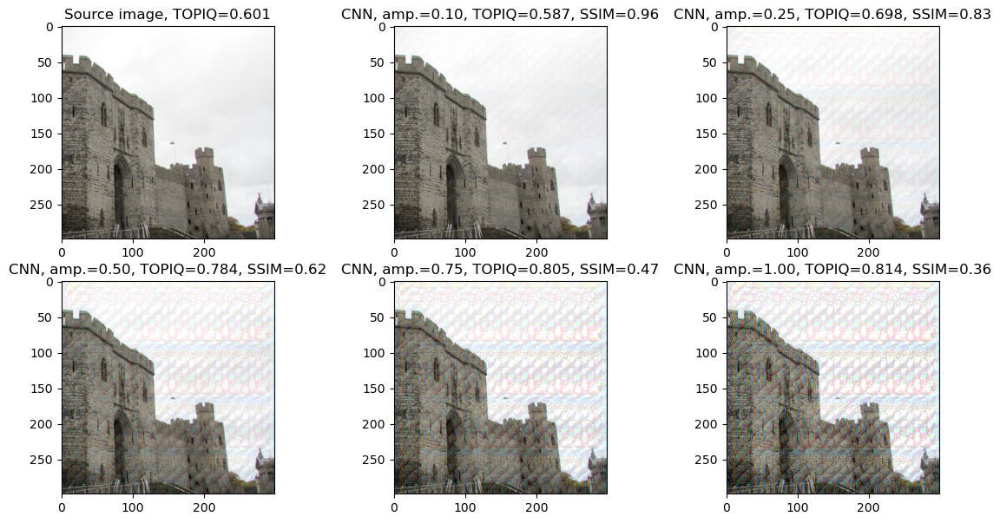

In [54]:
plt.figure(figsize=(14,7))
n_cols = 3
n_rows = 2
ax = plt.subplot(n_rows,n_cols,1)
ax.set_title(f'Source image, {iqa_name}={results[10][0.1]["clear"]:.3f}')
plt.imshow(img)
EPS = 25
for i in range(len(amps)):
    ax = plt.subplot(n_rows,n_cols,i+2)
    ax.set_title(f'CNN, amp.={amps[i]:.2f}, {iqa_name}={results[EPS][amps[i]]["attacked"]:.3f}, SSIM={results[EPS][amps[i]]["SSIM"]:.2f}')
    ax.axis('off')
    plt.imshow(image_to_numpy(imgs_dict[EPS][amps[i]]))

Как видно, сеть выучила некоторые репетативные паттерны, повторяющиеся по всему изображению. Сами паттерны, как видно ниже, зависят от содержимого изображения.

e:\anaconda\envs\mts\lib\site-packages\torchvision\transforms\functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


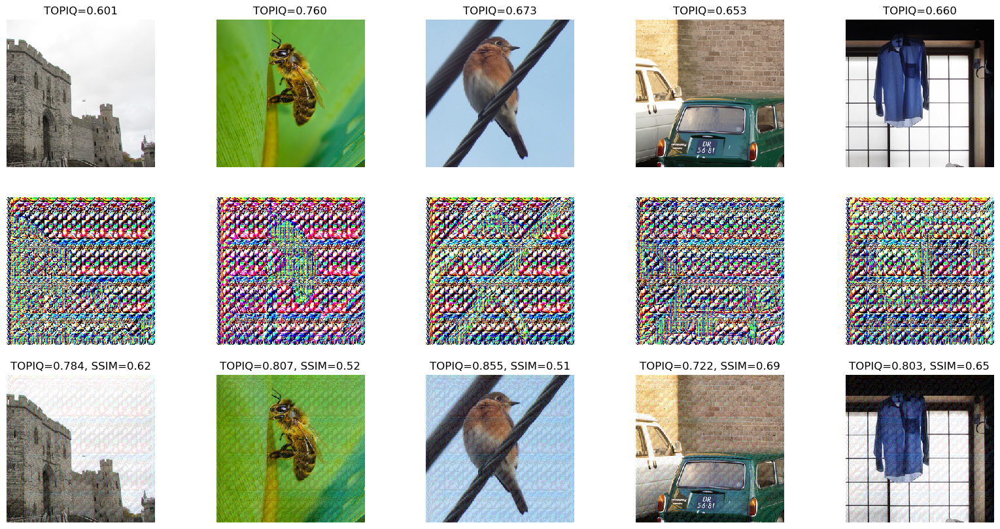

In [63]:
import os
from pathlib import Path
img_tensors = [transforms.ToTensor()(Image.open(str(x))).unsqueeze(0).to(DEVICE) for x in Path('./prey_images').iterdir()]
additives = [get_additive(unet_model, x) for x in img_tensors]
attacked_tensors = [apply_additive(additives[x], img_tensors[x], amp=0.5, eps=25/255.) for x in range(len(img_tensors))]
img_vals = [calc_scores(img_tensors[x], attacked_tensors[x]) for x in range(len(img_tensors))]
plt.figure(figsize=(20,10))

for i in range(len(img_tensors)):
    ax = plt.subplot(3,len(img_tensors), i + 1)
    ax.set_title(f'{iqa_name}={img_vals[i]["clear"]:.3f}')
    ax.axis('off')
    plt.imshow(image_to_numpy(img_tensors[i]), interpolation='none')

for i in range(len(attacked_tensors)):
    ax = plt.subplot(3,len(attacked_tensors), len(attacked_tensors) + i + 1)
    ax.axis('off')
    plt.imshow(image_to_numpy(additives[i] + 0.5), interpolation='none')

for i in range(len(attacked_tensors)):
    ax = plt.subplot(3,len(attacked_tensors), 2 * len(attacked_tensors) + i + 1)
    ax.set_title(f'{iqa_name}={img_vals[i]["attacked"]:.3f}, SSIM={img_vals[i]["SSIM"]:.2f}')
    ax.axis('off')
    plt.imshow(image_to_numpy(attacked_tensors[i]), interpolation='none')

Интересно, что модель, обученная с нуля всего 5 эпох для такой специфичной задачи, довольно неплохо научилась выделять объекты на изображении. Скорее всего, модель триггерится на границы на изображении (значит она сама научилась их выделять), но это так же может говорить и о каком то базовом уровне семантического понимания изображения. 

### UAP

Существуют и другие способы обучить универсальную добавку. Например, можно не усложнять задачу нейросетью, и вместо UNet'а обучать непосредственно саму добавку, как в итеративных атаках, после чего на стадии использования просто прибавлять ее к изображению. Такой принцип атаки называется `Universal Adversarial Patch (UAP)`. 

Полученная добавка, конечно, не будет зависеть от входного изображения, и потому будет менее эффективна, зато процесс применения атаки становится совсем простым, и его легко можно применять в качестве Real-Time препроцессинга (например, атакуя метрику качества, используемую при оценке алгоритмов сжатия, тем самым искусственно завышая качество своего алгоритма).

## Неограниченные атаки

Рассмотрим несколько примеров неограниченных атак, т.е. таких, которые не пытаются оставаться в $\epsilon$-шаре вокруг исходного изображения в какой либо норме. Цель таких атак - создать **новое** изображение, примерно похожее на оригинальное, при этом выглядещее натуралистично и атакующее целевую модель. В такой постановке простор для атаки куда шире, и ограничивается лишь ~~больной~~ фантазией авторов. Подходы варьируются от простой перекраски изображений до внесения в них точечных структурных изменений текстовым промптом с помощью [InstructPix2Pix диффузионной модели](https://arxiv.org/abs/2311.15551) (а сам промпт докучи генерируется по изображению с помощью GPT-4).

### CAdv: Adversarial colorization
[Атака](https://arxiv.org/pdf/1904.06347.pdf) изначально разрабатывалась против классификаторов и Image Captioning моделей. Суть атаки в том, чтобы с помощью предобученной колоризирующей модели перекрасить изображение так, чтобы максимально исказить выход целевой модели. При этом на изображении меняются только цвета, а структурная информация остается нетронутой.
![CAdv](imgs/cadv.png)

Оптимизируем в этой атаке не саму модель колоризации, а **цветовые подсказки** и **маску** (маска задает положение цветовых подсказок на исходном изображении), подающиеся на вход колоризующей модели.

Для выбора стартовых подсказок, изображение кластеризуется (KMeans), после чего из некоторого числа кластеров (мы используем 4 из 8) семплируются цветовые подсказки (50 штук). Выбор кластеров, откуда семплируются подсказки, осуществляется на основе энтропии, полученной из выходов колоризующей модели. Все это делается для того, чтобы итоговая колоризация была более натуральной.

In [13]:
import torch
import torch.nn as nn
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from sklearn.cluster import KMeans
from scipy.ndimage.filters import gaussian_filter
# вспомогательные функции для атаки
from cadv_utils import normalize, forward, compute_loss, compute_class, rgb2xyz, xyz2rgb, xyz2lab, lab2xyz, rgb2lab, lab2rgb

# колоризующая сеть
from cadv_color_model import color_net

# выбор подсказок
def get_colorization_data(im, model, device, k=4, n_clusters=8, hint=50):
    '''
    Convert image to LAB, and choose hints given clusters
    '''
    data = {}
    data_lab = rgb2lab(im)
    data['L'] = data_lab[:,[0,],:,:]
    data['AB'] = data_lab[:,1:,:,:]
    hints = data['AB'].clone()
    mask = torch.full_like(data['L'], -.5)

    with torch.no_grad():
        # Get original classification
        #target = classifier(normalize(im)).argmax(1)
        #print(f'Original class: {target.item()}, {opt.idx2label[target]}')

        N,C,H,W = hints.shape
        # Convert hints to numpy for clustering
        np_hints = hints.squeeze(0).cpu().numpy()
        np_hints = gaussian_filter(np_hints, 3).reshape([2,-1]).T
        #hints = median_filter(hints, size=10).reshape([2,-1]).T
        hints_q = KMeans(n_clusters=n_clusters).fit_predict(np_hints)

        # Calculate entropy based on colorization model. Use 0 hints for this
        logits, reg = model(data['L'], torch.zeros_like(hints).to(device), torch.full_like(mask, -.5).to(device))
        hints_distr = F.softmax(logits, dim=1).clamp(1e-8).squeeze(0)
        entropy = (-1 * hints_distr * torch.log(hints_distr)).sum(0)

        # upsample to original resolution
        entropy = F.interpolate(entropy[None,None,...], scale_factor=4, mode='nearest').squeeze().view(-1)

        # Calculate mean entropy of each clusters
        entropy_cluster = np.zeros(n_clusters)
        for i in range(n_clusters):
            class_entropy = entropy[(hints_q == i).nonzero()]
            entropy_cluster[i] = class_entropy.mean()

        # Choose clusters with largest entropy
        sorted_idx = np.argsort(entropy_cluster)
        idx = sorted_idx[:k] # obtain indices of clusters we want to give hints to
        idx = np.isin(hints_q, idx).nonzero()[0]

        # Sample randomly within the chosen clusters
        idx_rand = idx[np.random.choice(idx.shape[0], hint, replace=False)]
        chosen_hints = hints.view(N,C,-1)[...,idx_rand].clone()

        # Fill in hints values and corresponding mask values
        hints.fill_(0)
        hints.view(N,C,-1)[...,idx_rand] = chosen_hints
        mask.view(N,1,-1)[...,idx_rand] = .5

    data['hints'] = hints
    data['mask'] = mask
    return data


def cadv_attack(input_img, model=None, color_model=None, device='cpu', k=4, n_clusters=8, hint=50, iters=10):
    lr = 0.0005
    old_image = input_img.clone()
    old_w = input_img.shape[2]
    old_h = input_img.shape[3]
    w = (old_w // 4) * 4
    h = (old_h // 4) * 4
    input_img = input_img[:,:,:w,:h]
    input_img = input_img.to(device)


    data= get_colorization_data(input_img, color_model, device, k=k, n_clusters=n_clusters, hint=hint)
    optimizer = torch.optim.Adam([data['hints'].requires_grad_(), data['mask'].requires_grad_()], lr=lr, betas=(0.9, 0.999))

    for iteration in range(iters):
        out_class, out_reg = color_model(data['L'], data['hints'].clamp(-1,1), data['mask'].clamp(-.5,.5))
        input_img = lab2rgb(torch.cat((data['L'], out_reg), dim=1)).clamp(0,1)
        score = model(input_img.to(device))
        loss = 1 - score.to(device) 
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        input_img.data.clamp_(min=0, max=1)

    old_image[:,:,:w,:h] = input_img
    input_img = old_image
    res_image = (input_img).data.clamp_(min=0, max=1)

    return res_image


Предобученная колоризующая модель лежит [тут (Google Disk)](https://drive.google.com/drive/folders/1SfegeK_n9XmgQQQHEBmmOkMt2QmJLmXz?usp=sharing).

Посмотрим, что получается

In [19]:
color_model = color_net().eval().to(DEVICE)
color_model.load_state_dict(torch.load('./weights/cadv-colorization-model.pth'))
attacked_cadv = cadv_attack(img_tensor, iqa_model, color_model, device=DEVICE)

vals_cadv = calc_scores(img_tensor, attacked_cadv)

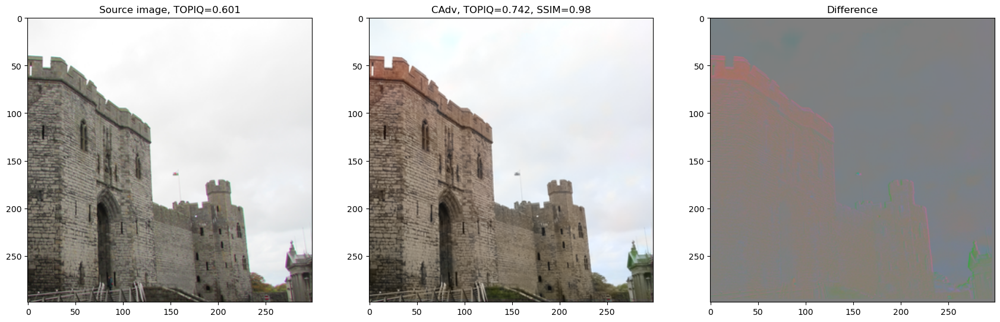

In [79]:
plt.figure(figsize=(21,7))
n_cols = 3
n_rows = 1
ax = plt.subplot(n_rows,n_cols,1)
ax.set_title(f'Source image, {iqa_name}={vals_cadv["clear"]:.3f}')
plt.imshow(img)

ax = plt.subplot(n_rows,n_cols,2)
ax.set_title(f'CAdv, {iqa_name}={vals_cadv["attacked"]:.3f}, SSIM={vals_cadv["SSIM"]:.2f}')
plt.imshow(image_to_numpy(attacked_cadv))
ax = plt.subplot(n_rows,n_cols,3)
ax.set_title(f'Difference')
plt.imshow(image_to_numpy(attacked_cadv - img_tensor + 0.5))


Как видим, структурно картинка не поменялась, изменилась лишь цветовая палитра. На разнице заметно отсутствие выскочастотных шумов, свойственных итеративным атакам в pixel-space. 

Посмотрим еще примеры

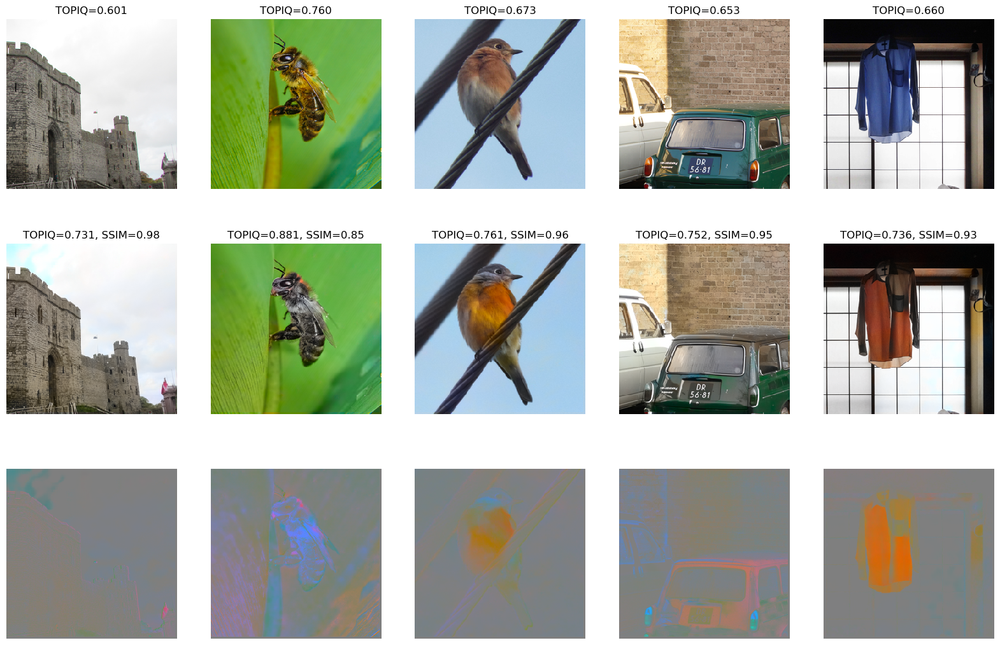

In [26]:
import os
from pathlib import Path
img_tensors = [transforms.ToTensor()(Image.open(str(x))).unsqueeze(0).to(DEVICE) for x in Path('./prey_images').iterdir()]
attacked_tensors = [cadv_attack(input_img=x, model=iqa_model, color_model=color_model, device=DEVICE) for x in img_tensors]
values = [calc_scores(img_tensors[x], attacked_tensors[x]) for x in range(len(img_tensors))]
plt.figure(figsize=(20,13))
for i in range(len(img_tensors)):
    ax = plt.subplot(3,len(img_tensors), i + 1)
    ax.set_title(f'{iqa_name}={values[i]["clear"]:.3f}')
    ax.axis('off')
    plt.imshow(image_to_numpy(img_tensors[i]), interpolation='none')

for i in range(len(attacked_tensors)):
    ax = plt.subplot(3,len(attacked_tensors), len(attacked_tensors) + i + 1)
    ax.set_title(f'{iqa_name}={values[i]["attacked"]:.3f}, SSIM={values[i]["SSIM"]:.2f}')
    ax.axis('off')
    plt.imshow(image_to_numpy(attacked_tensors[i]), interpolation='none')

for i in range(len(attacked_tensors)):
    ax = plt.subplot(3,len(attacked_tensors), 2*len(attacked_tensors) + i + 1)
    #ax.set_title(f'Difference')
    ax.axis('off')
    plt.imshow(image_to_numpy(attacked_tensors[i] - img_tensors[i] + 0.5), interpolation='none')

В случае атаки на классификатор, все довольно однозначно - если на атакованной картинке модель выдала другой класс, то она однозначно ошиблась. А считать ли полученное таким образом изображение, на котором метрика выдает повышенное значение, adversarial примером для метрики? Ведь возможно, что после колоризации субъективное качество улучшилось? Для корректной оценки в таких случаях стоит провести эксперимент с субъективным сравнением людьми.

### StAdv: Adversarial Deformation

Авторы [этой](https://arxiv.org/abs/1801.02612) атаки попробовали атаковать классификаторы путем обучения деформирующего преобразования. В процессе атаки оптимизируется векторное поле (тензор 2 x H x W), которым смещают пиксели исходного изображения. 
![image.png](imgs/stadv.png)

Векторное поле дополнительно регуляризируется с помощью total variation:
![stadv_flow_loss.png](./imgs/stadv_flow_loss.png)

In [15]:
from stadv_utils import rank_loss, metric_calc, flow_loss
METRIC_MAX_VAL = 1.0

# функция для применения поля-деформации к изображению
def flow_st(images, flows, device='cpu'):
    images_shape = images.size()
    flows_shape = flows.size()
    batch_size = images_shape[0]
    H = images_shape[2]
    W = images_shape[3]
    basegrid = torch.stack(torch.meshgrid(torch.arange(0,H), torch.arange(0,W))) #(2,H,W)
    sampling_grid = basegrid.unsqueeze(0).type(torch.float32).to(device) + flows.to(device)
    sampling_grid_x = torch.clamp(sampling_grid[:,1],0.0,W-1.0).type(torch.float32)
    sampling_grid_y = torch.clamp(sampling_grid[:,0],0.0,H-1.0).type(torch.float32)

    x0 = torch.floor(sampling_grid_x).type(torch.int64)
    x1 = x0 + 1
    y0 = torch.floor(sampling_grid_y).type(torch.int64)
    y1 = y0 + 1

    x0 = torch.clamp(x0, 0, W - 2)
    x1 = torch.clamp(x1, 0, W - 1)
    y0 = torch.clamp(y0, 0, H - 2)
    y1 = torch.clamp(y1, 0, H - 1)

    Ia = images[:,:,y0[0,:,:], x0[0,:,:]]
    Ib = images[:,:,y1[0,:,:], x0[0,:,:]]
    Ic = images[:,:,y0[0,:,:], x1[0,:,:]]
    Id = images[:,:,y1[0,:,:], x1[0,:,:]]

    x0 = x0.type(torch.float32)
    x1 = x1.type(torch.float32)
    y0 = y0.type(torch.float32)
    y1 = y1.type(torch.float32)

    wa = (x1 - sampling_grid_x) * (y1 - sampling_grid_y)
    wb = (x1 - sampling_grid_x) * (sampling_grid_y - y0)
    wc = (sampling_grid_x - x0) * (y1 - sampling_grid_y)
    wd = (sampling_grid_x - x0) * (sampling_grid_y - y0)
    perturbed_image = wa.unsqueeze(0)*Ia+wb.unsqueeze(0)*Ib+wc.unsqueeze(0)*Ic+wd.unsqueeze(0)*Id

    return perturbed_image.type(torch.float32).to(device)


def stadv_attack(input_img, model=None, metric_range=1, device='cpu', iters=10, lr=2.5, alpha=50, beta=1e-5):

    input_prey = input_img.clone().to(device)
    flows = np.zeros((1,2,) + input_img.size()[2:])
    #print(flows.shape)
    flows = torch.from_numpy(flows)
    flows = torch.autograd.Variable(flows).to(device)
    flows.requires_grad = True
    opt = torch.optim.LBFGS([flows], lr=lr, max_iter=1, max_eval=25)

    def closure():
        opt.zero_grad()

        pert_out = flow_st(input_prey, flows, device)
        
        s_adv, s_other = metric_calc(model, pert_out, None, maxval=metric_range)
        L_adv = rank_loss(s_adv, s_other)
        
        L_flow = flow_loss(flows, device=device)
        
        L_final = alpha * L_adv + beta * L_flow
    
        model.zero_grad()
        L_final.backward()
        return L_final 

    for i in range(iters):
        opt.step(closure)
        
    x_adv = flow_st(input_img.clone().to(device), flows, device)
    return x_adv.detach(), flows.detach()


Посмотрим на результат атаки и получившееся векторное поле

In [42]:
attacked_stadv, flows = stadv_attack(img_tensor, iqa_model, metric_range=1, device=DEVICE)
flows_np = flows.permute(0,2,3,1).squeeze().detach().cpu().numpy()

vals_stadv = calc_scores(img_tensor, attacked_stadv)

In [45]:
# функция для визуализации векторного поля цветом: разные направления будут задаваться разными цветами, а интенсивность определяется величиной вектора
def get_flow_vis(flow):
    hsv = np.zeros((flow.shape[0], flow.shape[1], 3), dtype=np.uint8)
    hsv[..., 1] = 255
    mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
    hsv[..., 0] = ang * 180 / np.pi / 2
    hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)
    bgr = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
    return rgb

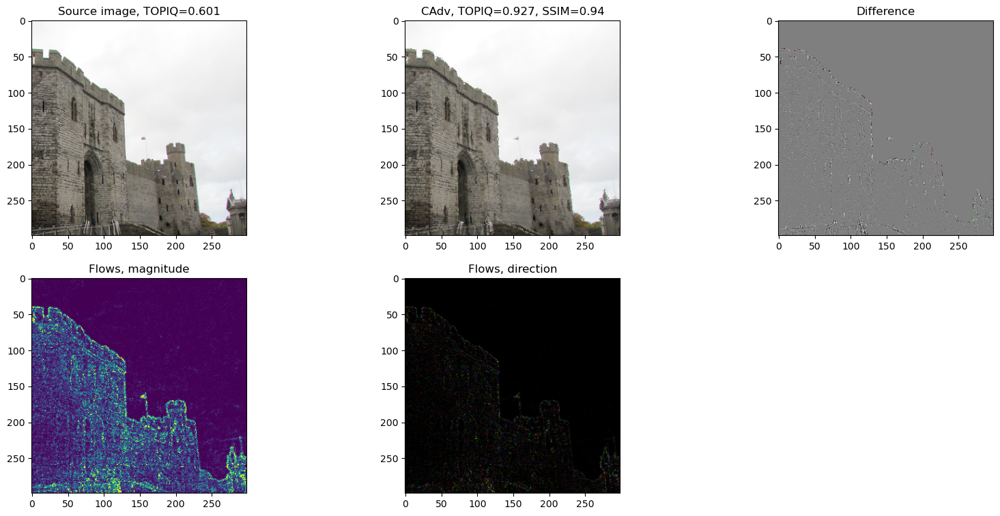

In [46]:
plt.figure(figsize=(20,9))
n_cols = 3
n_rows = 2
ax = plt.subplot(n_rows,n_cols,1)
ax.set_title(f'Source image, {iqa_name}={vals_stadv["clear"]:.3f}')
plt.imshow(img)

ax = plt.subplot(n_rows,n_cols,2)
ax.set_title(f'CAdv, {iqa_name}={vals_stadv["attacked"]:.3f}, SSIM={vals_stadv["SSIM"]:.2f}')
plt.imshow(image_to_numpy(attacked_stadv))
ax = plt.subplot(n_rows,n_cols,3)
ax.set_title(f'Difference')
plt.imshow(image_to_numpy(attacked_stadv - img_tensor + 0.5))

ax = plt.subplot(n_rows,n_cols,4)
ax.set_title(f'Flows, magnitude')
plt.imshow(image_to_numpy(torch.sqrt((flows**2).sum(dim=1)).unsqueeze(0)))

ax = plt.subplot(n_rows,n_cols,5)
ax.set_title(f'Flows, direction')
plt.imshow(get_flow_vis(flows_np))

Из плюсов атаки - она не добавляет на изображение новых цветов, только перемещает пиксели исходного изображения. Однако получаемые изображения выглядят не очень естественно, по крайней мере при атаке этой IQA метрики с текущими параметрами.

Посмотрим еще немного визуализаций

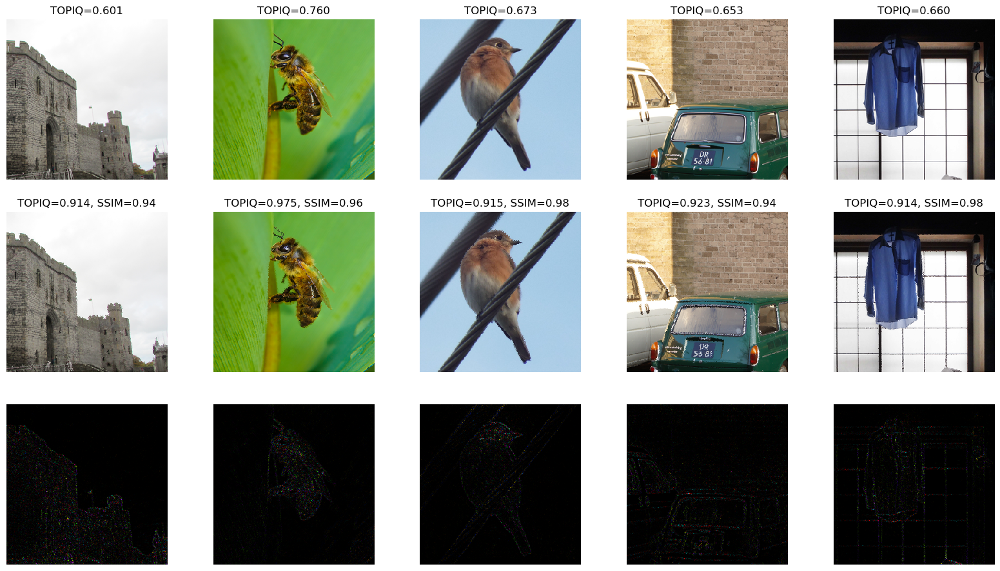

In [50]:
import os
from pathlib import Path
img_tensors = [transforms.ToTensor()(Image.open(str(x))).unsqueeze(0).to(DEVICE) for x in Path('./prey_images').iterdir()]
attacked_tensors = [stadv_attack(input_img=x, model=iqa_model, device=DEVICE)[0] for x in img_tensors]
flows = [stadv_attack(input_img=x, model=iqa_model, device=DEVICE)[1].permute(0,2,3,1).squeeze().detach().cpu().numpy() for x in img_tensors]
values = [calc_scores(img_tensors[x], attacked_tensors[x]) for x in range(len(img_tensors))]
n_rows = 3
n_cols = len(img_tensors)
plt.figure(figsize=(20,11))
for i in range(len(img_tensors)):
    ax = plt.subplot(n_rows,n_cols, i + 1)
    ax.set_title(f'{iqa_name}={values[i]["clear"]:.3f}')
    ax.axis('off')
    plt.imshow(image_to_numpy(img_tensors[i]), interpolation='none')

for i in range(len(attacked_tensors)):
    ax = plt.subplot(n_rows,n_cols, len(attacked_tensors) + i + 1)
    ax.set_title(f'{iqa_name}={values[i]["attacked"]:.3f}, SSIM={values[i]["SSIM"]:.2f}')
    ax.axis('off')
    plt.imshow(image_to_numpy(attacked_tensors[i]), interpolation='none')

for i in range(len(attacked_tensors)):
    ax = plt.subplot(n_rows,n_cols, 2*len(attacked_tensors) + i + 1)
    ax.axis('off')
    plt.imshow(get_flow_vis(flows[i]), interpolation='none')

Интересно, что деформации сильнее всего на границах, то есть при оптимизации поля атака их неявно выделила сама. Видимо, граничные деформации сильнее всего влияют на целевую модель, и меньше штрафуются регуляризирующей компонентой лосса.

## Другие атаки

Существует еще бесчисленное множество интересных подходов, на рассмотрение которых можно потратить далеко не одну пару. Далее для ознакомления представлено несколько примеров интересных атак с использованием генеративных моделей.

### [Instruct2Attack](https://arxiv.org/pdf/2311.15551.pdf)
![image.png](imgs/instruct_attack.png)

Схема атаки:

![image.png](imgs/instruct_attack_scheme.png)

### [AdvDiffuser](https://openaccess.thecvf.com/content/ICCV2023/papers/Chen_AdvDiffuser_Natural_Adversarial_Example_Synthesis_with_Diffusion_Models_ICCV_2023_paper.pdf)
![image.png](imgs/AdvDiffuser.png)

Схема: 

![image.png](imgs/AdvDiffuser_scheme.png)
